In [1]:
import Pkg
Pkg.activate(".")

  Activating project at `~/Documents/programming/BME-502-2025`


In [4]:
Pkg.add(["Turing","Distributions","Statistics","StatsPlots","Random","FillArrays"])

   Resolving package versions...
  No Changes to `~/Documents/programming/BME-502-2025/Project.toml`
  No Changes to `~/Documents/programming/BME-502-2025/Manifest.toml`


In [6]:
using Turing, Distributions, Statistics, StatsPlots, Random, FillArrays

In [7]:
rwd = Normal(0,1)

Normal{Float64}(μ=0.0, σ=1.0)

In [8]:
rw_steps = rand(rwd,999)

999-element Vector{Float64}:
  0.8978971841452763
  2.7101482989712857
 -0.17535611345703622
 -0.9192658116243623
  0.18247704237800533
 -1.3100679197569407
  0.18524552978678227
 -1.1154493305908872
  2.124513972934323
  0.9270392754458893
  0.5100142326786049
  1.9098939793777692
 -0.6794036603850547
  ⋮
  0.008393821537568092
 -1.356122492762106
 -0.2645341479848134
 -0.7048907089239982
  0.42407004990952984
 -0.5856352751464663
  0.9061217619660928
 -0.681412647288638
 -1.0036339910401677
  2.0005387710526437
 -1.6121560479956816
 -0.3612475854617961

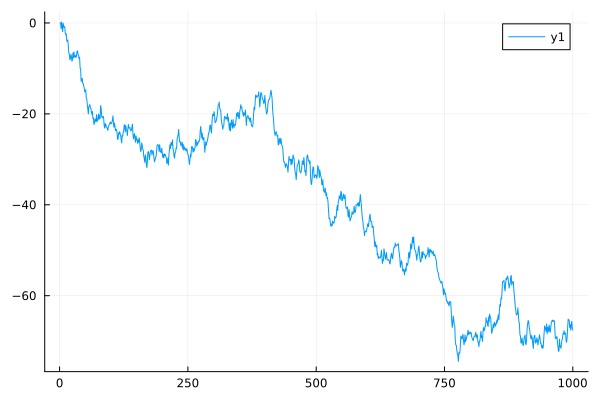

In [15]:
function create_rw(sigma,steps)
    rw_steps = rand(Normal(0,sigma),steps-1)
    x = [0.0]
    for step in rw_steps
        push!(x,x[end]+step)
    end
    return x
end
x = create_rw(1,1000)
plot(x)

In [16]:
walks = []
for i in 1:100
    push!(walks,create_rw(1.0,1000))
end

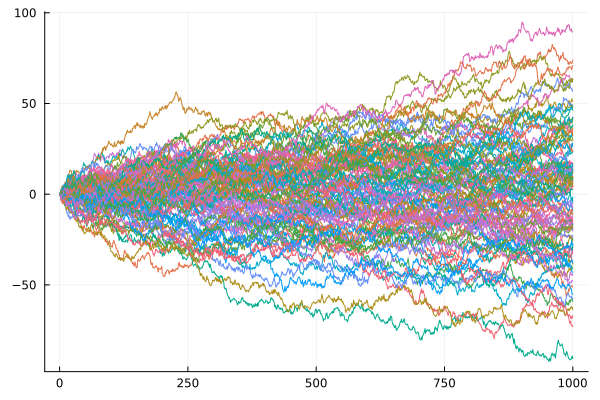

In [18]:
plot(walks, legend=nothing)

In [32]:
walks_squared = []
for i in 1:1000
    push!(walks_squared,create_rw(1.0,1000) .^ 2)
end

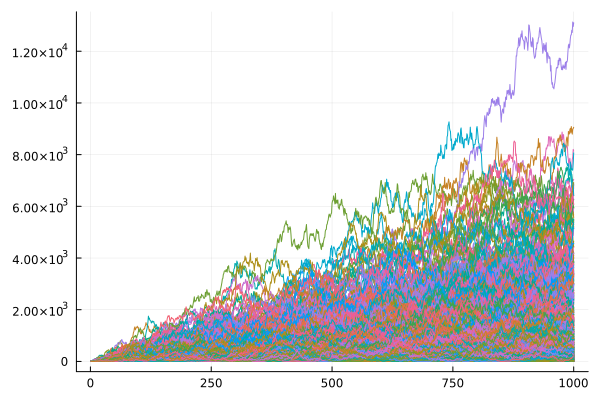

In [33]:
plot(walks_squared, legend=nothing)

In [24]:
walks_squared

100-element Vector{Any}:
 [0.0, 0.002830398975642785, 0.2550938858533874, 4.375353788839537, 11.780201646912692, 18.99188468250509, 16.488615583808432, 5.66754386484743, 4.12011076113429, 3.6841029876876012  …  1867.680352045634, 1870.9836610384734, 1909.3189496756609, 1935.4827995090332, 1821.368826841815, 1687.1646546397935, 1678.4971183553578, 1588.996500015783, 1647.5816488305397, 1596.7932843670894]
 [0.0, 3.7656408083142425, 3.7867598925450574, 1.0956353446585045, 1.985055148463646, 0.0146228792024755, 1.1942687407318375, 0.0402529869720549, 0.13340426384841386, 0.5396649258406804  …  7053.741137322618, 7067.939769062777, 7561.055391140875, 8026.912623719747, 7754.071273462312, 7536.098365628176, 7616.106449146628, 7432.224654220409, 7175.933575315635, 7021.51396739932]
 [0.0, 0.23300862511741846, 0.13454512503549396, 0.03907591962210627, 0.3809232694114986, 0.15049849789815378, 1.351436581597507, 0.531792677943686, 0.012621478183405548, 0.19828761251259824  …  137.8205123288225,

In [34]:
walks_array = reduce(hcat, walks_squared)

1000×1000 Matrix{Float64}:
   0.0          0.0         0.0         …     0.0           0.0
   0.0300243    0.413092    0.00500402        1.49833       0.784474
   2.35336      8.70119     0.0321474         5.28535       0.375753
   3.11698     26.2021      1.09103           0.436762      0.947236
   4.57052     27.0549      2.24959           2.27295       0.240169
   1.99691     25.7615      2.40799     …     0.308862      0.212282
   3.6466      26.6864      0.00126746        1.31935       0.163221
   4.21155     39.7869      5.36332           0.327295      1.98036
   0.813414    28.9059      0.0213515         0.0278474     0.787445
   3.16188     53.2974      0.00145495        1.25088       5.2082
  16.5506      52.6689      1.46876     …     0.368281      5.78819
  20.896       92.1662      4.50764           1.46448       3.26606
  16.5054      94.2974      3.07174           2.15987       6.34872
   ⋮                                    ⋱                
 706.615      118.656     813

In [27]:
hcat([1,2],[2,3])

2×2 Matrix{Int64}:
 1  2
 2  3

In [35]:
walks_mean = vec(mean(walks_array,dims=2))

1000-element Vector{Float64}:
    0.0
    1.0053148645375671
    2.0287345389647653
    2.974857607154841
    3.791370035761358
    4.694757342254944
    5.841809158976375
    6.859603627426525
    7.717762493340806
    8.713856120287609
    9.623942432735474
   10.72581388339005
   11.749247521732313
    ⋮
 1004.903119577415
 1005.8179322711911
 1005.079225948207
 1006.7561847512047
 1007.9339989178031
 1010.3501253564001
 1012.6729264823825
 1013.137884931267
 1017.3070994490636
 1021.3229438046147
 1024.0689017653067
 1026.1237635117068

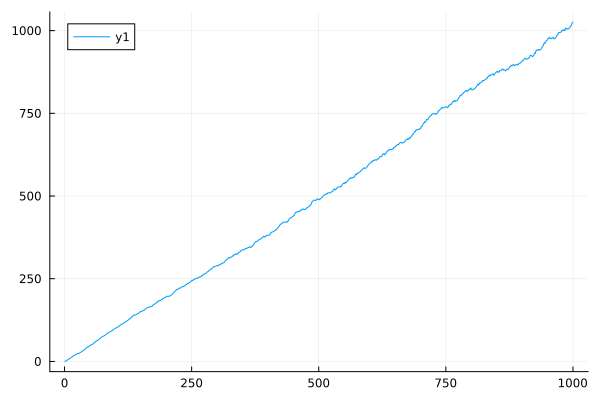

In [36]:
plot(walks_mean)

In [37]:
x

1000-element Vector{Float64}:
   0.0
   0.019058386839987087
  -1.2194547662075046
   0.2127106859876695
  -0.9063018413553181
  -1.9425699362928583
  -0.039125313335745204
  -0.8358689101225464
  -0.9747880610121378
  -0.7983964764027416
  -2.179595671805535
  -2.623700054452437
  -2.396196281553258
   ⋮
 -69.0821349445524
 -66.96222935129977
 -65.18119830744237
 -65.31935876287189
 -65.39832291751954
 -67.02506391025487
 -66.36568640443484
 -67.58999805973198
 -66.37252268285192
 -65.64620278477038
 -67.17772886049406
 -67.55661433579264

In [38]:
steps_recovered = []
for i in 1:length(x)-1
    push!(steps_recovered,x[i+1]-x[i])
end

In [39]:
steps_recovered

999-element Vector{Any}:
  0.019058386839987087
 -1.2385131530474918
  1.432165452195174
 -1.1190125273429876
 -1.0362680949375402
  1.9034446229571131
 -0.7967435967868012
 -0.1389191508895914
  0.1763915846093962
 -1.3811991954027936
 -0.444104382646902
  0.22750377289917934
 -1.6070618274764659
  ⋮
  1.1657533015335417
  2.119905593252625
  1.7810310438573964
 -0.13816045542951372
 -0.07896415464765028
 -1.6267409927353356
  0.6593775058200322
 -1.224311655297143
  1.21747537688006
  0.7263198980815417
 -1.5315260757236757
 -0.3788854752985884

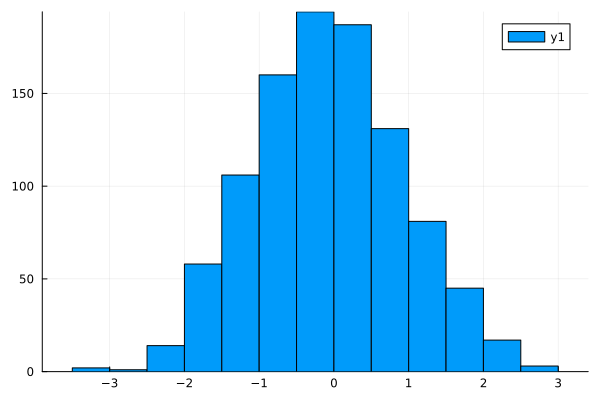

In [41]:
histogram(steps_recovered)

In [42]:
std(steps_recovered)

0.996168626789976

In [43]:
@model function std_gaussian(x)
    σ ~ Uniform(0.1,5.0)
    for i in 1:length(x)
        x[i] ~ Normal(0,σ)
    end
end

std_gaussian (generic function with 2 methods)

In [44]:
mygaussian = std_gaussian(steps_recovered)

DynamicPPL.Model{typeof(std_gaussian), (:x,), (), (), Tuple{Vector{Any}}, Tuple{}, DynamicPPL.DefaultContext}(Main.std_gaussian, (x = Any[0.019058386839987087, -1.2385131530474918, 1.432165452195174, -1.1190125273429876, -1.0362680949375402, 1.9034446229571131, -0.7967435967868012, -0.1389191508895914, 0.1763915846093962, -1.3811991954027936  …  1.7810310438573964, -0.13816045542951372, -0.07896415464765028, -1.6267409927353356, 0.6593775058200322, -1.224311655297143, 1.21747537688006, 0.7263198980815417, -1.5315260757236757, -0.3788854752985884],), NamedTuple(), DynamicPPL.DefaultContext())

In [45]:
chain = sample(mygaussian, NUTS(0.65),1000)

┌ Info: Found initial step size
└   ϵ = 0.025

Sampling: 100%|█████████████████████████████████████████| Time: 0:00:01

Chains MCMC chain (1000×13×1 Array{Float64, 3}):

Iterations        = 501:1:1500
Number of chains  = 1
Samples per chain = 1000
Wall duration     = 4.76 seconds
Compute duration  = 4.76 seconds
parameters        = σ
internals         = lp, n_steps, is_accept, acceptance_rate, log_density, hamiltonian_energy, hamiltonian_energy_error, max_hamiltonian_energy_error, tree_depth, numerical_error, step_size, nom_step_size

Summary Statistics
  parameters      mean       std      mcse   ess_bulk   ess_tail      rhat   e ⋯
      Symbol   Float64   Float64   Float64    Float64    Float64   Float64     ⋯

           σ    0.9992    0.0235    0.0012   367.2382   674.8356    1.0091     ⋯
                                                                1 column omitted

Quantiles
  parameters      2.5%     25.0%     50.0%     75.0%     97.5% 
      Symbol   Float64   Float64   Float64   Float64   Float64 

           σ    0.9540    0.9829    0.9989    1.0138    1.0475


In [46]:
1/sqrt(1000)

0.03162277660168379

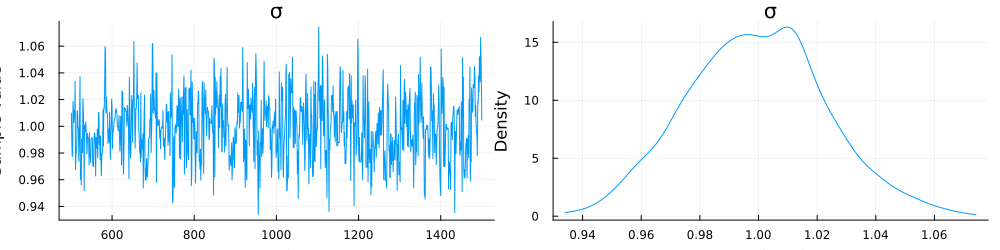

In [47]:
plot(chain)